In [10]:
include("/Users/meesvandartel/Desktop/Coursework/CGT/DeepEWA/ProbsEWA.jl")
using Flux, .pEWA, Random, IterTools, ProgressMeter, DataFrames, CSV, Statistics

#### Attraction updating function:
$$
Q_{i}^{\mu}(t) = \frac{(1-\alpha) N(t-1) Q_{i}^{\mu}(t-1)}{N(t)} + \frac{\left[ \delta + (1-\delta) \mathbb{I}(s_i^\mu,s^{-\mu}(t)) \right] \Pi^\mu(s_i^\mu, s^{-\mu}(t))}{N(t)}
$$

#### Mixed strategy determination:
$$
\sigma^{\mu}(t)=\frac{e^{\beta Q_1^R (t)}}{e^{\beta Q_1^R (t)} + e^{\beta Q_2^R (t)}}
$$


#### Special Cases:
$$ 
\begin{aligned}
&\text{best response dynamics:  }\alpha=1, \quad \beta = +\infty, \quad \delta = 1, \quad \forall \kappa \in [0,1] \\
&\text{reinforcement learning:  }\delta = 0, \quad \forall \kappa \in [0,1] \\
&\quad\text{average RL: } \quad \kappa=0, \quad \text{cummulative RL: } \quad \kappa = 1 \\
&\text{ficticious play:  }\alpha=0, \quad \beta = +\infty, \quad \delta = 1, \quad  \kappa = 0\\
&\quad\text{stochastic ficticious play:  } \beta < +\infty\\
&\text{replicator dynamics:  } \beta \rightarrow 0, \quad \alpha = 0, \quad \delta = 1, \quad \forall \kappa \in (0,1]\\
&\text{logit dynamics:  } \alpha = 1, \quad \delta = 1,\quad \kappa = 1
\end{aligned}
$$ 

In [11]:
# this data will be for this specific coordination game with 2 NE and 1 mixed NE.
coord = [[[5 1; 1 4], [5 1; 1 4]], pEWA.find_NE_mixed([[5 1; 1 4], [5 1; 1 4]])]
dom = [[[5 0; 20 1], [5 0; 20 1]], pEWA.find_NE_mixed([[5 0; 20 1], [5 0; 20 1]])]
cyclic = [[[5 1;1 4],[-5 1; 1 -4]], pEWA.find_NE_mixed([[5 1;1 4],[-5 1; 1 -4]])]

# set game and amount of observations
game = coord
points = 50_000



50000

In [12]:
# generating data
α_grid, κ_grid, δ_grid = [rand(0.0:0.0001:1.0, points) for _ in 1:3]
β_grid = exp.(rand(1:0.001:6, points)) # take exp to get the lim to infty effect since β is unbounded above
#combs = [[α_grid[i], κ_grid[i], δ_grid[i], β_grid[i]] for i in 1:points]

#testing
combs = [[0.0, 1.0, δ_grid[i], β_grid[i]] for i in 1:points]

subset=Int64(floor(0.5*length(combs))) #60/40 train test split
x_train, x_test = combs[1:subset], combs[(subset+1):end]
y_train, y_test = Vector{Int64}(undef, length(x_train)),Vector{Int64}(undef, length(x_test))

# should take about 6min for 1mil obs
@showprogress for i in 1:length(x_train)
    comb=x_train[i]
    α, κ, δ, β = comb
    params = pEWA.init_pEWA(;α=α, κ=κ, δ=δ, β=β,game=game)
    cat = pEWA.multicat_pEWA(params)
    y_train[i] = cat
end

@showprogress for i in 1:length(x_test)
    comb = x_test[i]
    α, κ, δ, β = comb
    params = pEWA.init_pEWA(;α=α, κ=κ, δ=δ, β=β,game=game)
    cat = pEWA.multicat_pEWA(params)
    y_test[i] = cat
end

x_train = hcat([Float32.(x[1:4]) for x in x_train]...)
x_test = hcat([Float32.(x[1:4]) for x in x_test]...)

Progress: 100%|█████████████████████████████████████████| Time: 0:01:44
Progress: 100%|█████████████████████████████████████████| Time: 0:01:45


4×25000 Matrix{Float32}:
 0.0       0.0       0.0      0.0     …   0.0      0.0      0.0       0.0
 1.0       1.0       1.0      1.0         1.0      1.0      1.0       1.0
 0.4848    0.0199    0.5315   0.5621      0.0511   0.5327   0.9819    0.3875
 5.70304  50.2997  145.329   19.5309     74.0692  18.3568  78.1008  143.309

In [13]:
# 4 layer dense model
deepEWA= Chain(
    Dense(4 => 32, relu),
    Dense(32 => 32, relu),
    Dense(32 => 32, relu),
    Dense(32 => 4)
    )

# specify data loader and optimiser 
target = Flux.onehotbatch(y_train, 1:4)   
loader = Flux.DataLoader((x_train, target), batchsize=64, shuffle=true);
opt = Flux.setup(Flux.AdaGrad(), deepEWA)

# training loop
losses=[]
@showprogress for epoch in 1:1000
    for xy in loader
        x,y = xy
        loss, grads = Flux.withgradient(deepEWA) do m
            y_hat = m(x)
            # cross entropy for classification
            Flux.logitcrossentropy(y_hat, y)
        end
        Flux.update!(opt, deepEWA, grads[1])
        push!(losses, loss)
    end
end

# generate test data
out2 = deepEWA(x_test)
probs2 = softmax(out2)
predicted_labels = Flux.onecold(probs2, 1:4)
print("done")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:30


done

In [14]:

# Define the mapping of numbers to strings
number_to_string = Dict(
    1 => "Cycles/Chaos",
    2 => "Mixed FP",
    3 => "Pure FP",
    4 => "Pure NE"
)

# Convert numbers to strings using the dictionary
labels_str = map(x -> string(number_to_string[x]), predicted_labels)
y_str =  map(x -> string(number_to_string[x]), y_test)



25000-element Vector{String}:
 "Pure NE"
 "Pure NE"
 "Cycles/Chaos"
 "Pure NE"
 "Mixed FP"
 "Pure NE"
 "Pure FP"
 "Pure NE"
 "Cycles/Chaos"
 "Cycles/Chaos"
 "Pure NE"
 "Pure NE"
 "Pure NE"
 ⋮
 "Pure NE"
 "Pure NE"
 "Pure NE"
 "Pure NE"
 "Pure NE"
 "Pure NE"
 "Cycles/Chaos"
 "Pure NE"
 "Pure NE"
 "Cycles/Chaos"
 "Pure NE"
 "Pure NE"

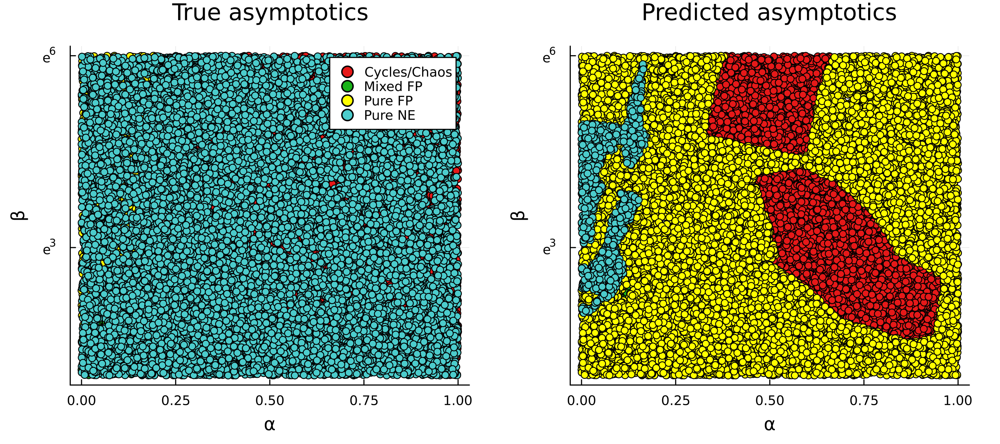

In [15]:
using Plots, Measures

# Define custom palette and labels
custom_palette = [RGB(0.9, 0.1, 0.1), RGB(0.1, 0.7, 0.1), RGB(0.3, 0.8, 0.8), RGB(1.0, 1.0, 0.0)]

# Plot for true convergence
p_true = scatter(
    x_test[3, :], 
    x_test[4, :], 
    group=y_str, 
    title="True asymptotics", 
    legend=true,
    markersize=3.5, 
    palette=custom_palette, 
    yscale=:ln,
    xlabel="α", 
    ylabel="β"
)

# Plot for predicted convergence
p_done = scatter(
    x_test[3, :], 
    x_test[4, :], 
    group=predicted_labels, 
    title="Predicted asymptotics", 
    legend=false,
    markersize=3.5, 
    palette=custom_palette, 
    yscale=:ln,
    xlabel="α", 
    ylabel="β" 
)

# Combine plots
plot_combined = plot(p_true, p_done, layout=(1, 2), size=(900, 400), dpi=300, 
margins=5mm)

# Display the combined plot
plot_combined



In [16]:
accuracy = mean(predicted_labels .== y_test)
savefig(plot_combined, "coord3_plot.png")

"/Users/meesvandartel/Desktop/Coursework/CGT/DeepEWA/coord3_plot.png"

In [17]:
accuracy

0.62556